In [1]:
#%matplotlib notebook
import sys
import os

# Standard modules used through the notebook 
import numpy as np
import matplotlib.pyplot as plt


import json

# Display and interface settings (just for the notebook interface)
%matplotlib inline
%load_ext autoreload
%autoreload 2
np.set_printoptions(linewidth=150)

### Teaser

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


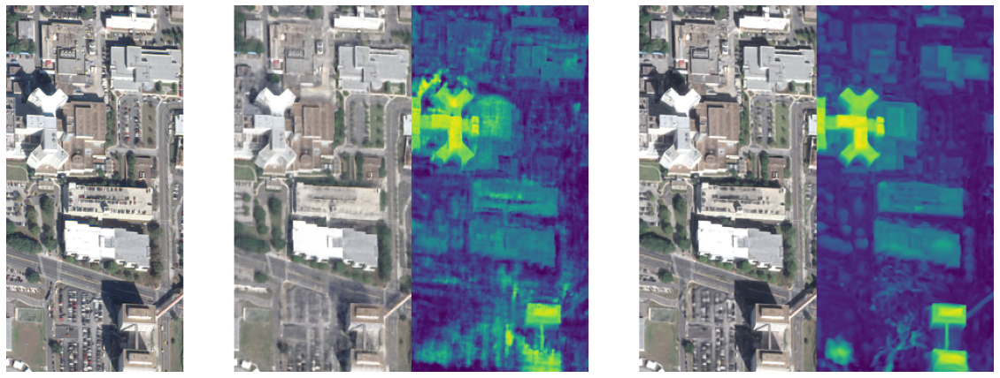

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


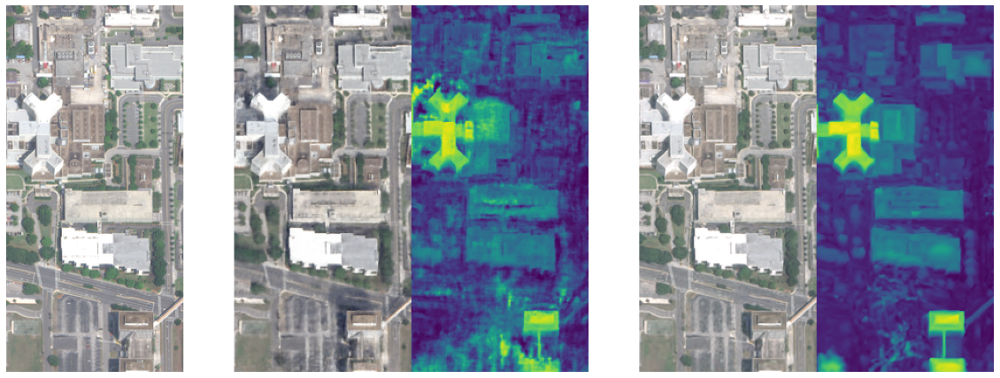

In [274]:
from PIL import Image
import glob
import rasterio


import cv2

def visualize_depth(depth, cmap=cv2.COLORMAP_JET, clip=False, mi=None, ma=None):
    
    cmap = cv2.COLORMAP_VIRIDIS
    """
    depth: (H, W)
    """
    x = depth
    #x = np.nan_to_num(x) # change nan to 0
    if mi is None:
        mi = np.nanmin(x) if not clip else np.nanpercentile(x, 1) # get minimum depth
    if ma is None:
        ma = np.nanmax(x) if not clip else np.nanpercentile(x, 90)
    x = (x-mi)/(ma-mi) # normalize to 0~1
    x = np.clip(x, 0, 1)
    x = (255.*x).astype(np.uint8)
    x = np.clip(x, 0, 255)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    x_ = x_ / 255.
    return x_


img_size=512

gt_img_dir = "/mnt/cdisk/roger/Datasets/DFC2019/Track3-RGB/JAX_068"
nerf_eval_aoi_dir = "/mnt/cdisk/roger/nerf_output/results/eval_aoi/2021-12-06_21-40-55_JAX_068_512_classic_train"
satnerf_eval_aoi_dir = "/mnt/cdisk/roger/nerf_output/results/eval_aoi/2021-12-04_16-00-11_JAX_068_v7_imsize512_train"

im1 = {}
im1["paths"] = [gt_img_dir + "/JAX_068_009_RGB.tif",
                nerf_eval_aoi_dir + "/rgb/JAX_068_009_RGB_epoch56.tif",
                nerf_eval_aoi_dir + "/depth/JAX_068_009_RGB_epoch56.tif",
                satnerf_eval_aoi_dir + "/rgb/JAX_068_009_RGB_epoch56.tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_009_RGB_epoch56.tif"]
im1["win"] = np.array([600, 700, 1500, 700]) // 4
   
im2 = {}
im2["paths"] = [gt_img_dir + "/JAX_068_013_RGB.tif",
                nerf_eval_aoi_dir + "/rgb/JAX_068_013_RGB_epoch56.tif",
                nerf_eval_aoi_dir + "/depth/JAX_068_013_RGB_epoch56.tif",
                satnerf_eval_aoi_dir + "/rgb/JAX_068_013_RGB_epoch56.tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_013_RGB_epoch56.tif"]
im2["win"] = np.array([600, 700, 1500, 700]) //4

for im_dict in [im1, im2]:
    im = []
    for i, p in enumerate(im_dict["paths"]):
        row0, col0, h, w = im_dict["win"]
        with rasterio.open(p, 'r') as f:
            img = np.transpose(f.read(), (1, 2, 0))
        if img.shape[0] != img_size:
            img = Image.fromarray(img)
            img = img.resize((img_size, img_size), Image.LANCZOS)
            img = np.array(img) / 255.
        if img.shape[2] == 1:
            img = visualize_depth(img)
        im.append(img[row0:row0+h, col0:col0+w, :])
        if i in [0, 2]:
            im.append(255*np.ones((im[-1].shape[0], 50, 3), dtype=np.int32))
    im = np.hstack(im)

    plt.figure(figsize=(20,20))
    plt.imshow(im)
    plt.axis('off')
    plt.show()

### Create new teaser

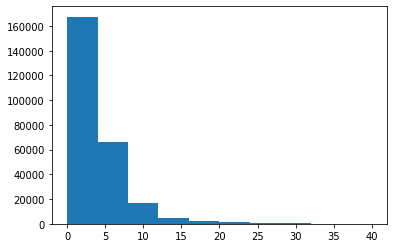

AVG MAE /mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-21_23-32-54_JAX_068_512_classic_/train/dsm_errs/JAX_068_004_RGB_epoch51.tif: 3.879


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(200, 825, 3)


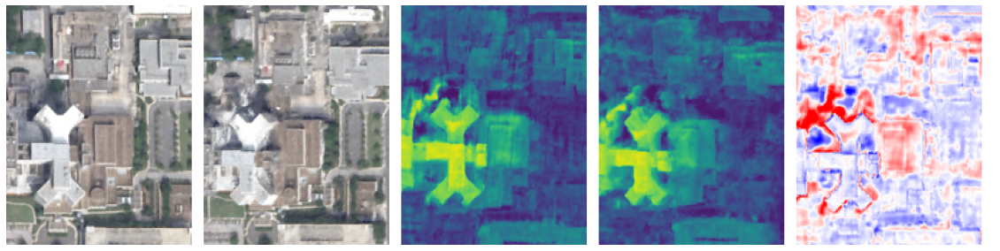

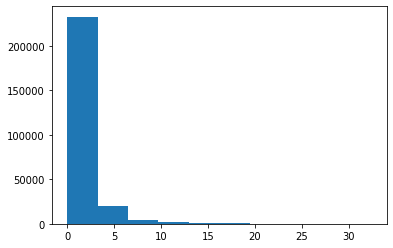

AVG MAE /mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-22_18-11-56_JAX_068_512_satnerf_/train/dsm_errs/JAX_068_004_RGB_epoch51.tif: 1.600


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(200, 825, 3)


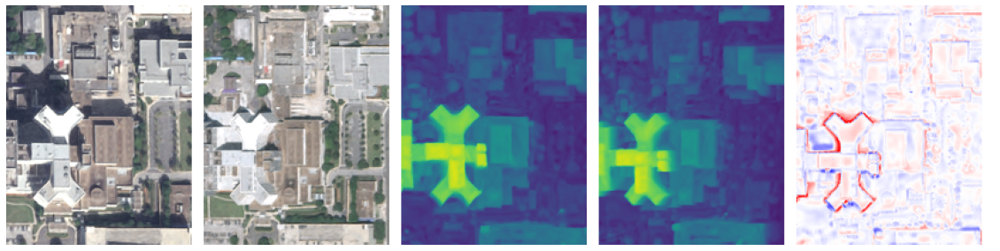

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(200, 825, 3)


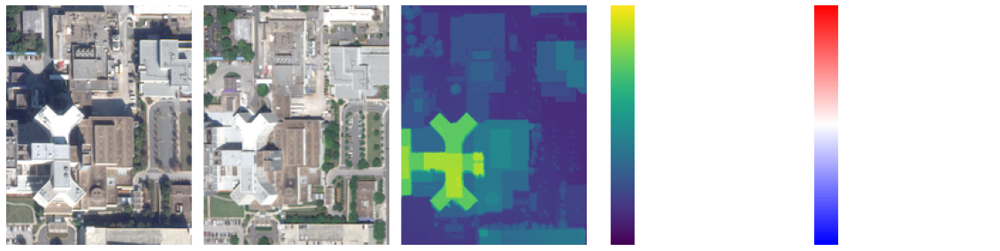

In [190]:
# here
import cmapy

def create_cmap_img(h, w, cmap=cv2.COLORMAP_VIRIDIS):
    x = np.hstack([np.linspace(0, 1, h).reshape(-1, 1)[::-1] for i in range(w)])
    x = (255*x).astype(np.uint8)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    return x_

def visualize_depth_v2(depth, clip=False, vmax=None, vmin=None):
    
    cmap = cv2.COLORMAP_VIRIDIS
    """
    depth: (H, W)
    """
    x = depth
    #x = np.nan_to_num(x) # change nan to 0
    mi = np.min(x) if vmin is None else vmin
    ma = np.max(x) if vmax is None else vmax
    x = (x-mi)/(ma-mi) # normalize to 0~1
    x = np.clip(x, 0, 1)
    x = (255.*x).astype(np.uint8)
    x = np.clip(x, 0, 255)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    x_ = x_ / 255.
    return x_


# sat-nerf results
img_size=512
nerf_eval_aoi_dir = "/mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-21_23-32-54_JAX_068_512_classic_/train"
satnerf_eval_aoi_dir = "/mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-22_18-11-56_JAX_068_512_satnerf_/train"

nerf_epoch = "51"
satnerf_epoch="51"
im1_id = "007"
im2_id = "015"

im1 = {}
im1["paths"] = [nerf_eval_aoi_dir + "/rgb/JAX_068_" + im1_id + "_RGB_epoch" + nerf_epoch + ".tif",
                nerf_eval_aoi_dir + "/rgb/JAX_068_" + im2_id + "_RGB_epoch" + nerf_epoch + ".tif",
                nerf_eval_aoi_dir + "/depth/JAX_068_" + im1_id + "_RGB_epoch" + nerf_epoch + ".tif",
                nerf_eval_aoi_dir + "/depth/JAX_068_" + im2_id + "_RGB_epoch" + nerf_epoch + ".tif",
                nerf_eval_aoi_dir + "/dsm_errs/JAX_068_004_RGB_epoch" + nerf_epoch + ".tif"]
im1["win"] = np.array([630, 670, 800, 620]) // 4

im2 = {}
im2["paths"] = [satnerf_eval_aoi_dir + "/rgb/JAX_068_" + im1_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/rgb/JAX_068_" + im2_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_" + im1_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_" + im2_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/dsm_errs/JAX_068_004_RGB_epoch" + satnerf_epoch + ".tif"]
im2["win"] = np.array([630, 670, 800, 620]) //4

sys.path.append('/home/roger/PycharmProjects/satnerf_reg')
from sun_interp import hstack_dsm_tifs_v1, hstack_dsm_tifs_v2
import cv2

max_depth_err = 20
cmap_id = "bwr"

for im_dict in [im1, im2]:
    im = []
    for i, p in enumerate(im_dict["paths"]):
        row0, col0, h, w = im_dict["win"]
        if "/dsm_errs/" in p:
            #img = hstack_dsm_tifs_v2([p], cmap=cv2.COLORMAP_JET, crop=False, vmax=max_depth_err)
            with rasterio.open(p, "r") as f:
                tmp = f.read(1)
                plt.figure()
                plt.hist(abs(tmp.ravel()))
                plt.show()
                print("AVG MAE {}: {:.3f}".format(p, np.nanmean(abs(tmp.ravel()))))
            img = hstack_dsm_tifs_v2([p], cmap=cmapy.cmap(cmap_id), crop=False, vmax=max_depth_err, vmin=-max_depth_err)
            img = Image.fromarray(img)
            img = img.resize((im[-1].shape[0], im[-1].shape[0]), Image.LANCZOS)
            img = np.array(img)/255.
        else:
            with rasterio.open(p, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
        if img.shape[0] != img_size and not "/dsm_errs/" in p:
            img = Image.fromarray(img)
            img = img.resize((img_size, img_size), Image.LANCZOS)
            img = np.array(img) / 255.
        if img.shape[2] == 1:
            img = visualize_depth_v2(img, vmax=30, vmin=-30)
        if "/dsm_errs/" in p:
            img = img[:, 10:165, :]
        else:
            img = img[row0:row0+h, col0:col0+w, :]
    
        """
        if i == 4:
            cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_JET)
            white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
            cmap_img = np.hstack([white, cmap_img, white])/255
            img = np.hstack([img, cmap_img])
        if i == 3:
            cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_VIRIDIS)
            white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
            cmap_img = np.hstack([white, cmap_img, white])/255
            img = np.hstack([img, cmap_img])
        """

        im.append(img)
        im.append(255*np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
    im = np.hstack(im) 

    print(im.shape)
    
    plt.figure(figsize=(20,20))
    plt.imshow(im)
    plt.axis('off')
    plt.show()
    
    
# plot input views, colormaps and gt
img_paths = [nerf_eval_aoi_dir + "/gt_rgb/JAX_068_" + im1_id + "_RGB_epoch" + nerf_epoch + ".tif",
             nerf_eval_aoi_dir + "/gt_rgb/JAX_068_" + im2_id + "_RGB_epoch" + nerf_epoch + ".tif",
             "/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/JAX_068_DSM.tif"]
im = []
for i, p in enumerate(img_paths):
    row0, col0, h, w = 630//4, 670//4, 800//4, 620//4
    if "_DSM.tif" in p:
        img = hstack_dsm_tifs_v2([p], cmap=cv2.COLORMAP_VIRIDIS, crop=False, vmin=-30, vmax=30)
        img = Image.fromarray(img)
        img = img.resize((im[-1].shape[0], im[-1].shape[0]), Image.LANCZOS)
        img = np.array(img)/255.
    else:
        with rasterio.open(p, 'r') as f:
            img = np.transpose(f.read(), (1, 2, 0))
    if "_DSM.tif" in p:
        img = img[:, 10:165, :]
    else:
        img = img[row0:row0+h, col0:col0+w, :]
    
    #if i == 2:
    #    im.append(255*np.ones((im[-1].shape[0], 330, 3), dtype=np.int32))
        
    if i == 2:
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_VIRIDIS)
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        img = np.hstack([img, cmap_img])
    
    im.append(img)
    im.append(255*np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
    
    if i == 2:
        im.append(255*np.ones((im[-1].shape[0], 100, 3), dtype=np.int32))
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cmapy.cmap(cmap_id))
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        im.append(cmap_img)
        im.append(255*np.ones((im[-1].shape[0], 110, 3), dtype=np.int32))

im = np.hstack(im)
print(im.shape)
plt.figure(figsize=(20,20))
plt.imshow(im)
plt.axis('off')
plt.show()

### New new teaser

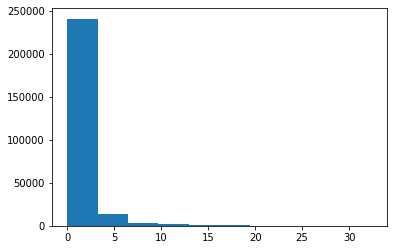

AVG MAE /mnt/cdisk/roger/nerf_output-crops3/results/eval_aoi/2022-02-22_19-01-03_o_JAX_068_full_snerf_beta_SCx0.1_1st_iters_2ndepoch/train/dsm_errs/JAX_068_011_RGB_epoch25.tif: 1.244


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(700, 3050, 3)


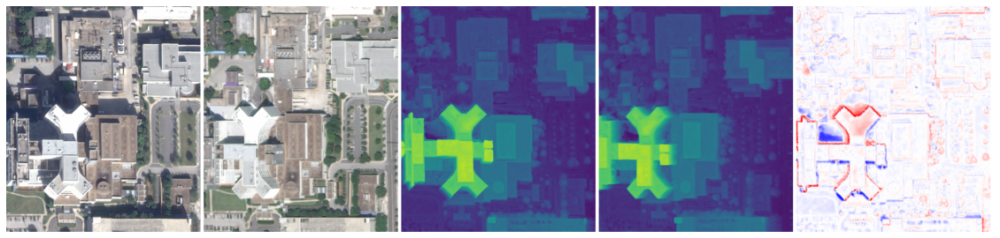

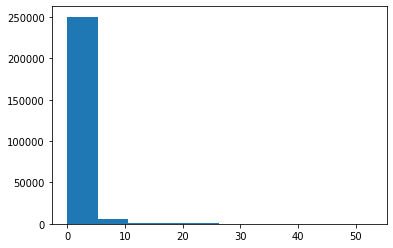

AVG MAE /mnt/cdisk/roger/s2p_dsms/PAN/JAX_068_ba_v2_PAN/rmvs_med_err_10_pairs.tif: 1.174


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


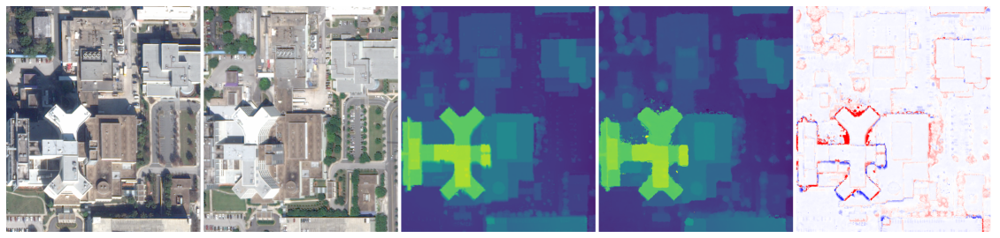

In [1211]:
# sat-nerf results
img_size=512
satnerf_eval_aoi_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/eval_aoi/2022-02-22_19-01-03_o_JAX_068_full_snerf_beta_SCx0.1_1st_iters_2ndepoch/train"

#nerf_epoch = "51"
satnerf_epoch="25"
im1_id = "007"
im2_id = "015"

im2 = {}
im2["paths"] = [satnerf_eval_aoi_dir + "/rgb/JAX_068_" + im1_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/rgb/JAX_068_" + im2_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_" + im1_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/depth/JAX_068_" + im2_id + "_RGB_epoch" + satnerf_epoch + ".tif",
                satnerf_eval_aoi_dir + "/dsm_errs/JAX_068_011_RGB_epoch" + satnerf_epoch + ".tif"]
im2["win"] = np.array([0, 0, 750, 600])

sys.path.append('/home/roger/PycharmProjects/satnerf_reg')
from sun_interp import hstack_dsm_tifs_v1, hstack_dsm_tifs_v2
import cv2

max_depth_err = 20
cmap_id = "bwr"

from torchvision import transforms as T
from PIL import Image
import torch

im = []
im_dict = im2
for i, p in enumerate(im_dict["paths"]):
    row0, col0, h, w = im_dict["win"]
    if "/dsm_errs/" in p:
        #img = hstack_dsm_tifs_v2([p], cmap=cv2.COLORMAP_JET, crop=False, vmax=max_depth_err)
        with rasterio.open(p, "r") as f:
            tmp = f.read(1)
            plt.figure()
            plt.hist(abs(tmp.ravel()))
            plt.show()
            print("AVG MAE {}: {:.3f}".format(p, np.nanmean(abs(tmp.ravel()))))
        img = hstack_dsm_tifs_v2([p], cmap=cmapy.cmap(cmap_id), crop=False, vmax=max_depth_err, vmin=-max_depth_err)
        img = Image.fromarray(img)
        img = img.resize((im[-1].shape[0], im[-1].shape[0]), Image.LANCZOS)
        img = np.array(img)/255.
    else:
        with rasterio.open(p, 'r') as f:
            img = np.transpose(f.read(), (1, 2, 0))
    H, W, D = img.shape
    if img.shape[0] != img_size and not "/dsm_errs/" in p:
        img = np.transpose(img, (2, 0, 1))
        img = T.Resize(size=(700, W*700//H), interpolation=Image.BICUBIC)(torch.Tensor(img))
        img = np.transpose(img.numpy(), (1, 2, 0))
    if img.shape[2] == 1:
        img = visualize_depth_v2(img, vmax=30, vmin=-30)
    #if "/dsm_errs/" in p:
    #    img = img[:, 10:165, :]
    #else:
    img = img[row0:row0+h, col0:col0+w, :]

    """
    if i == 4:
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_JET)
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        img = np.hstack([img, cmap_img])
    if i == 3:
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_VIRIDIS)
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        img = np.hstack([img, cmap_img])
    """

    im.append(img)
    im.append(255*np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im) 

print(im.shape)

plt.figure(figsize=(20,20))
plt.imshow(im)
plt.axis('off')
plt.show()
    
    
# plot input views, colormaps and gt
img_paths = [satnerf_eval_aoi_dir + "/gt_rgb/JAX_068_" + im1_id + "_RGB_epoch" + satnerf_epoch + ".tif",
             satnerf_eval_aoi_dir + "/gt_rgb/JAX_068_" + im2_id + "_RGB_epoch" + satnerf_epoch + ".tif",
             "/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/JAX_068_DSM.tif",
             "/mnt/cdisk/roger/s2p_dsms/PAN/JAX_068_ba_v2_PAN/rmvs_med_dsm_10_pairs_1.174.tif",
             "/mnt/cdisk/roger/s2p_dsms/PAN/JAX_068_ba_v2_PAN/rmvs_med_err_10_pairs.tif"]
im = []
for i, p in enumerate(img_paths):
    row0, col0, h, w = im_dict["win"]
    if "rmvs_med_err" in p:
        #img = hstack_dsm_tifs_v2([p], cmap=cv2.COLORMAP_JET, crop=False, vmax=max_depth_err)
        with rasterio.open(p, "r") as f:
            tmp = f.read(1)
            plt.figure()
            plt.hist(abs(tmp.ravel()))
            plt.show()
            print("AVG MAE {}: {:.3f}".format(p, np.nanmean(abs(tmp.ravel()))))
        img = hstack_dsm_tifs_v2([p], cmap=cmapy.cmap(cmap_id), crop=False, vmax=max_depth_err, vmin=-max_depth_err)
        img = Image.fromarray(img)
        img = img.resize((im[-1].shape[0], im[-1].shape[0]), Image.LANCZOS)
        img = np.array(img)/255.
    elif "_DSM.tif" in p or "/PAN/" in p:
        img = hstack_dsm_tifs_v2([p], cmap=cv2.COLORMAP_VIRIDIS, crop=False, vmin=-30, vmax=30)
        img = Image.fromarray(img)
        img = img.resize((im[-1].shape[0], im[-1].shape[0]), Image.LANCZOS)
        img = np.array(img)/255.
    else:
        with rasterio.open(p, 'r') as f:
            img = np.transpose(f.read(), (1, 2, 0))
    H, W, D = img.shape
    if img.shape[0] != img_size and not "/dsm_errs/" in p:
        img = np.transpose(img, (2, 0, 1))
        img = T.Resize(size=(700, W*700//H), interpolation=Image.BICUBIC)(torch.Tensor(img))
        img = np.transpose(img.numpy(), (1, 2, 0))

    img = img[row0:row0+h, col0:col0+w, :]
    
    """
    if i == 2:
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_VIRIDIS)
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        img = np.hstack([img, cmap_img])
    """
    im.append(img)
    im.append(255*np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
    
    """
    if i == 2:
        im.append(255*np.ones((im[-1].shape[0], 100, 3), dtype=np.int32))
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cmapy.cmap(cmap_id))
        white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        cmap_img = np.hstack([white, cmap_img, white])/255
        im.append(cmap_img)
        im.append(255*np.ones((im[-1].shape[0], 110, 3), dtype=np.int32))
    """

im = np.hstack(im)
plt.figure(figsize=(20,20))
plt.imshow(im)
plt.axis('off')
plt.show()

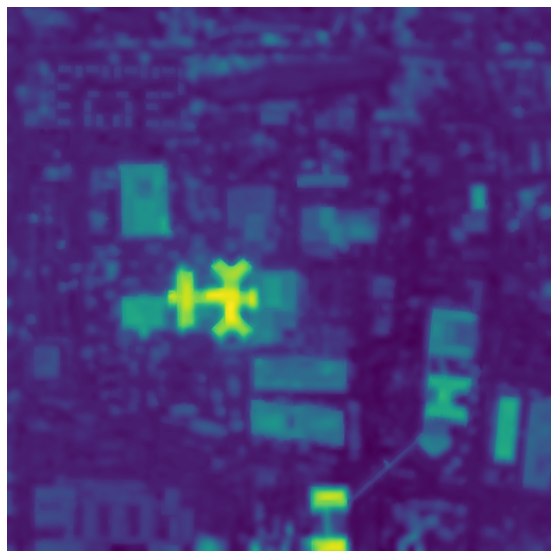

In [31]:
import cv2

g_p= '/mnt/cdisk/roger/nerf_output/logs/2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5/train/rgb/JAX_068_013_RGB_epoch60.tif'
d_p= '/mnt/cdisk/roger/nerf_output/logs/2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5/train/depth/JAX_068_013_RGB_epoch60.tif'
os.path.exists(d_p)

with rasterio.open(g_p, 'r') as f:
    img_rgb = np.transpose(f.read(), (1, 2, 0))
with rasterio.open(d_p, 'r') as f:
    img_d = np.transpose(f.read(), (1, 2, 0))

    
guid = cv2.ximgproc.guidedFilter(img_rgb, img_d, 3, 1e-1)

plt.figure(figsize=(10,10))
plt.imshow(guid)
plt.axis('off')
plt.show()

#from cv2.ximgproc import guidedFilter

### Use uncertainty to boost DSM accuracy

In [34]:
from datasets import SatelliteDataset
from eval_aoi import load_nerf, batched_inference, save_nerf_output_to_images
import torch

run_id = "2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5"
logs_dir = "/mnt/cdisk/roger/nerf_output/logs"
checkpoints_dir = None
epoch_number = 56

img_id = "JAX_068_009_RGB"
img_size=512
t = 2

# load dataset of 1 image
log_path = os.path.join(logs_dir, run_id)
with open('{}/opts.json'.format(log_path), 'r') as f:
        args = json.load(f)
reference_image = os.path.join(args["root_dir"], img_id + ".json")        
dataset = SatelliteDataset(args["root_dir"], args["img_dir"], split="val",
                           img_downscale=args["img_downscale"], cache_dir=args["cache_dir"])
dataset.json_files = [reference_image]

# load nerf
if checkpoints_dir is None:
    checkpoints_dir = args["checkpoints_dir"]
models, conf = load_nerf(run_id, log_path, checkpoints_dir, epoch_number-1)

# run nerf
sample = dataset[0]
rays = sample["rays"]
ts = t * torch.ones(rays.shape[0], 1).long().cuda().squeeze()
results = batched_inference(models, rays.cuda(), ts, conf)

print("nerf run completed")

/home/roger/miniconda3/envs/nerf/lib/python3.6/site-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,


Using /mnt/cdisk/roger/nerf_output/checkpoints/2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5/epoch=55.ckpt


/home/roger/miniconda3/envs/nerf/lib/python3.6/site-packages/pytorch_lightning/metrics/__init__.py:44: LightningDeprecationWarning: `pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package (https://github.com/PyTorchLightning/metrics) since v1.3 and will be removed in v1.5
  "`pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package"
/home/roger/miniconda3/envs/nerf/lib/python3.6/site-packages/fsspec/__init__.py:47: DeprecationWarning: SelectableGroups dict interface is deprecated. Use select.
  for spec in entry_points.get("fsspec.specs", []):


nerf run completed


In [8]:
print(results['depth_coarse'].shape)
print(results['weights_coarse'].shape)

torch.Size([262144, 64])
torch.Size([262144, 64])


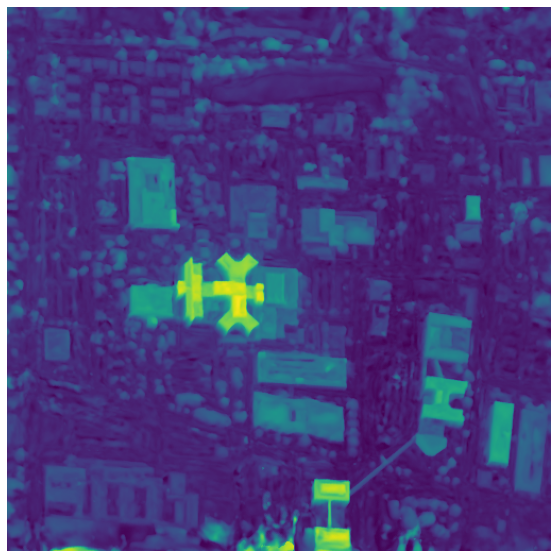

(512, 512, 1)


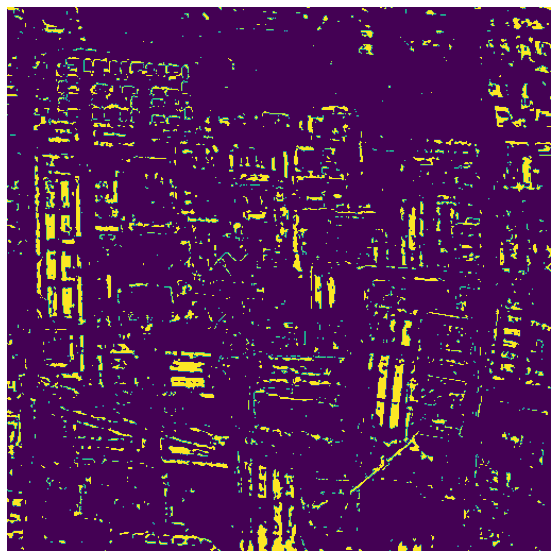

In [12]:
typ = "fine" if "rgb_fine" in results else "coarse"
depth = torch.sum(results['weights_coarse'] * results['depth_coarse'], -1)
_, _, alts = dataset.get_latlonalt_from_nerf_prediction(rays.cpu(), depth.cpu())
depth2 = alts.reshape(img_size, img_size, 1)

plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(depth2))
plt.axis('off')
plt.show()


beta = torch.sum(results['weights_coarse'].unsqueeze(-1) * results['beta_coarse'], -2)
beta = beta.cpu().numpy().reshape(img_size, img_size, 1)
print(beta.shape)
plt.figure(figsize=(10,10))
plt.imshow(beta[:, :, 0]>0.03)
plt.axis('off')
plt.show()

#plt.figure(figsize=(10,10))
#plt.imshow(visualize_depth(beta))
#plt.axis('off')
#plt.show()

In [88]:
beta[335-2:336+2, 160-2:161+2, 0]

array([[0.06226351, 0.04085693, 0.0326157 , 0.01737388, 0.01054742],
       [0.07343316, 0.05066523, 0.06482822, 0.08944219, 0.07954241],
       [0.07380389, 0.06762674, 0.11496087, 0.16079716, 0.15597792],
       [0.02743832, 0.03059088, 0.07493092, 0.15218395, 0.19960538],
       [0.00710689, 0.00776611, 0.01378491, 0.02611822, 0.04966334]], dtype=float32)

In [104]:
depth[335-2:336+2, 160-2:161+2, 0]

array([[-20.70602199, -21.65701366, -22.24647706, -22.31652783, -22.33159477],
       [-21.0306311 , -21.64512066, -22.05887022, -22.26479513, -22.27803866],
       [-21.22650058, -21.61128944, -21.65763246, -21.62473881, -21.43363532],
       [-21.76374829, -21.87405684, -21.66944982, -21.32894481, -21.0645337 ],
       [-22.27074666, -22.01463983, -21.89010715, -21.55728588, -21.21088855]])

[[0.11496087]]


<Figure size 720x720 with 0 Axes>

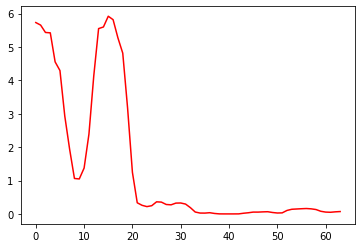

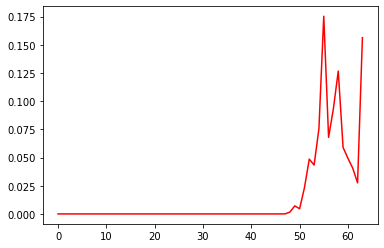

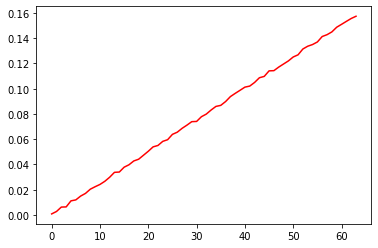

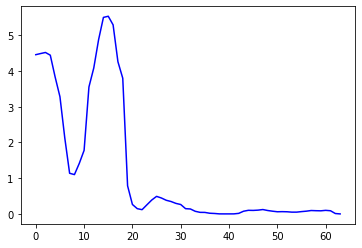

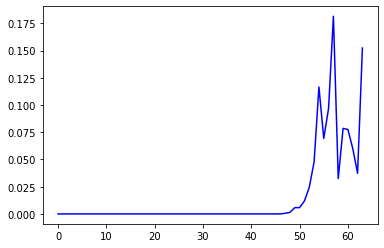

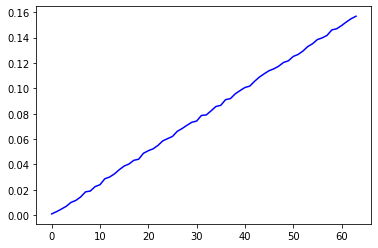

0.1435765


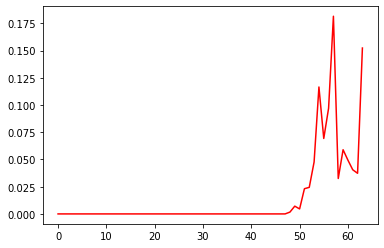

0.13590607
0.14402938


In [101]:
plt.figure(figsize=(10,10))
#plt.imshow(beta[320:360, 150:190, 0]>0.05)
print(beta[335:336, 160:161, 0])
b = results['beta_coarse'].cpu().numpy().reshape(img_size, img_size, 64)
w = results['weights_coarse'].cpu().numpy().reshape(img_size, img_size, 64)
d = results['depth_coarse'].cpu().numpy().reshape(img_size, img_size, 64)
plt.figure()

b1 = b[335, 160, :].copy()
w1 = w[335, 160, :].copy()
d1 = d[335, 160, :].copy()

b2 = b[335-1, 160, :].copy()
w2 = w[335-1, 160, :].copy()
d2 = d[335-1, 160, :].copy()


plt.plot(b1, c='r'); plt.show()
plt.plot(w1, c='r'); plt.show()
plt.plot(d1, c='r'); plt.show()
plt.plot(b2, c='b'); plt.show()
plt.plot(w2, c='b'); plt.show()
plt.plot(d2, c='b'); plt.show()

print(np.sum(d[335, 160, :]*w[335, 160, :]))

for n in range(64):
     if b1[n] > 0.05 and b2[n] < b1[n]:
            w1[n] = w2[n]
plt.plot(w1, c='r'); plt.show()
print(np.sum(w1*d1))
print(np.sum(w2*d2))

In [39]:
np.mean(tmp**2, axis=2)

array([[0.00100476, 0.00112545, 0.00082731, ..., 0.00098207, 0.00099643, 0.00099122],
       [0.00116006, 0.00103437, 0.00090829, ..., 0.00104655, 0.00102012, 0.00111644],
       [0.00135007, 0.00092228, 0.00096487, ..., 0.00100928, 0.0009716 , 0.00097942],
       ...,
       [0.00189817, 0.00170247, 0.00141161, ..., 0.00197257, 0.00226086, 0.00212688],
       [0.00196119, 0.00157003, 0.00135645, ..., 0.00359479, 0.00349082, 0.0035603 ],
       [0.00200516, 0.00166675, 0.00132092, ..., 0.00579032, 0.0046866 , 0.0042647 ]], dtype=float32)

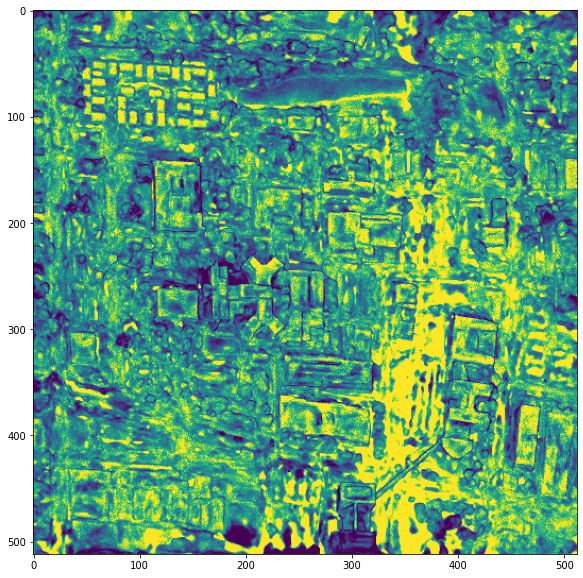

In [48]:
tmp = results["weights_coarse"].cpu().numpy().reshape(512, 512, 64)

plt.figure(figsize=(10, 10))
plt.imshow(visualize_depth(np.mean(tmp**2, axis=2), clip=True))
plt.show()

this took 1.49 seconds


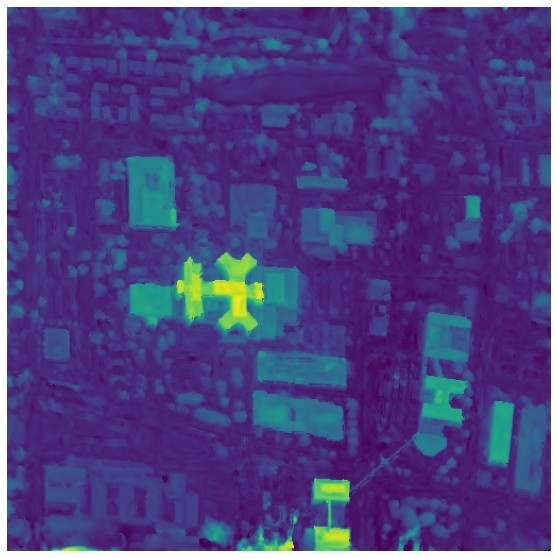

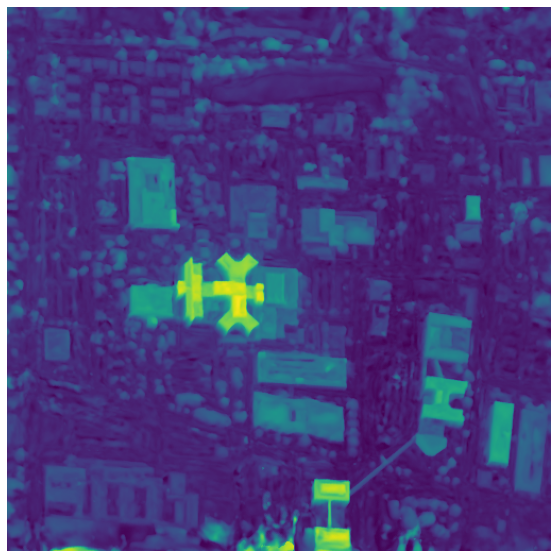

In [19]:
import timeit
import skimage

start = timeit.default_timer()

s=3
beta_win = skimage.util.view_as_windows(beta[:, :, 0], (s, s))
tmp = depth2.copy()
depth_win_ref = skimage.util.view_as_windows(tmp[:, :, 0], (s, s))
depth_win = skimage.util.view_as_windows(depth2[:, :, 0], (s, s))

for i in range(beta_win.shape[0]):
    for j in range(beta_win.shape[1]):
        dr_w = depth_win_ref[i, j, :, :]
        d_w = depth_win[i, j, :, :]
        b_w = beta_win[i, j, :, :]
        dr_w[b_w > 0.01] = d_w.ravel()[np.argmin(b_w.ravel())]

stop = timeit.default_timer()
print("this took {:.2f} seconds".format(stop-start))
    
plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(tmp))
plt.axis('off')
plt.show()


plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(depth2))
plt.axis('off')
plt.show()

In [7]:
import timeit
import skimage

start = timeit.default_timer()


typ = "fine" if "rgb_fine" in results else "coarse"
all_betas = results[f"beta_{typ}"].cpu().numpy()
all_depths = results[f"depth_{typ}"].cpu().numpy()
all_weights = results[f"weights_{typ}"].cpu().numpy()

s=7
ref_depth, ref_weights = [], []
for n in range(conf.n_samples):
    print(n)
    beta = all_betas[:, n, :].reshape(img_size, img_size)
    depth = all_depths[:, n].reshape(img_size, img_size).copy()
    weights = all_weights[:, n].reshape(img_size, img_size).copy()
    beta_win = skimage.util.view_as_windows(beta, (s, s))
    depth_win = skimage.util.view_as_windows(depth, (s, s))
    weights_win = skimage.util.view_as_windows(weights, (s, s))
    for i in range(beta_win.shape[0]):
        for j in range(beta_win.shape[1]):
            d_w = depth_win[i, j, :, :]
            b_w = beta_win[i, j, :, :]
            w_w = weights_win[i, j, :, :]
            #d_w[b_w > 0.05] = d_w.ravel()[np.argmin(b_w.ravel())]
            w_w[b_w > 0.05] = w_w.ravel()[np.argmin(b_w.ravel())]
    ref_depth.append(depth)
    ref_weights.append(weights)

stop = timeit.default_timer()
print("this took {:.2f} seconds".format(stop-start))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
this took 99.39 seconds


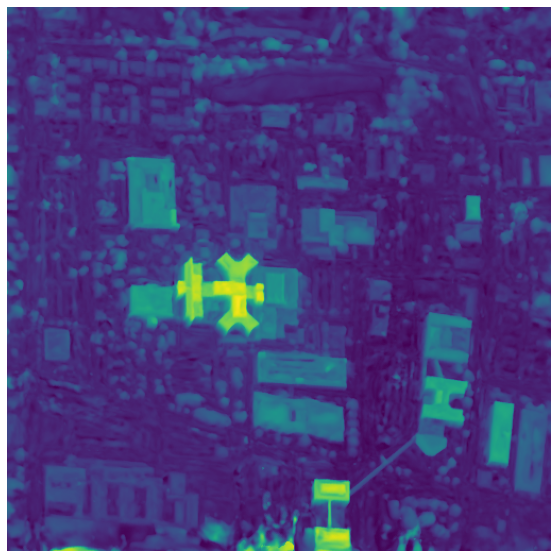

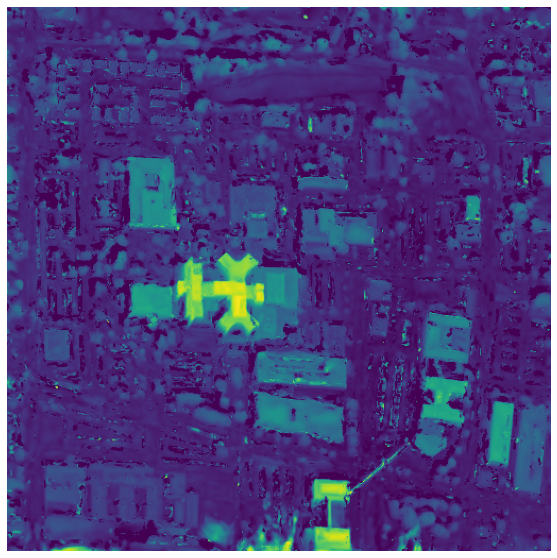

In [13]:
import cv2

def visualize_depth2(depth, depth2, cmap=cv2.COLORMAP_JET, clip=False):
    
    cmap = cv2.COLORMAP_VIRIDIS
    """
    depth: (H, W)
    """
    x = depth
    #x = np.nan_to_num(x) # change nan to 0
    mi = np.min(depth2) if not clip else np.percentile(x, 1) # get minimum depth
    ma = np.max(depth2) if not clip else np.percentile(x, 99)
    x = (x-mi)/(ma-mi) # normalize to 0~1
    x = np.clip(x, 0, 1)
    x = (255.*x).astype(np.uint8)
    x = np.clip(x, 0, 255)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    x_ = x_ / 255.
    return x_


postp_depth = np.dstack(ref_depth)
postp_weights = np.dstack(ref_weights)

output = np.sum(postp_weights * postp_depth, -1)
_, _, alts = dataset.get_latlonalt_from_nerf_prediction(rays.cpu(), torch.from_numpy(output.ravel()))
out_depth = alts.reshape(img_size, img_size, 1)

plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(depth2, clip=False))
plt.axis('off')
plt.show()


plt.figure(figsize=(10,10))
plt.imshow(visualize_depth2(out_depth, depth2, clip=False))
plt.axis('off')
plt.show()

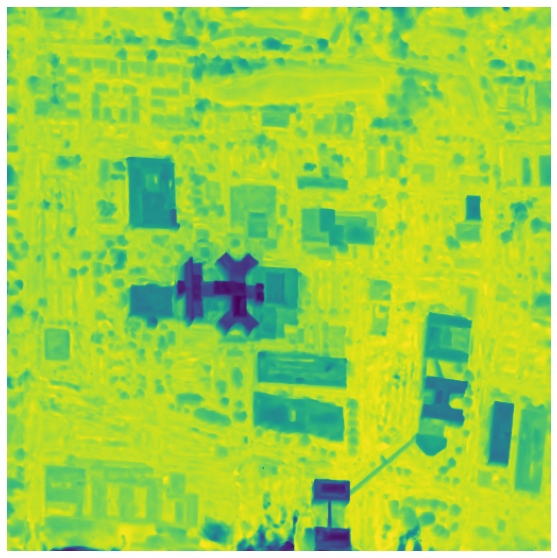

In [26]:
postp_depth = np.vstack([k.ravel() for k in ref_depth]).T

output = np.sum(results['weights_coarse'].cpu().numpy() * postp_depth, -1)
output = output.reshape(img_size, img_size, 1)
plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(output))
plt.axis('off')
plt.show()

(512, 512, 3)
(85, 101, 3)


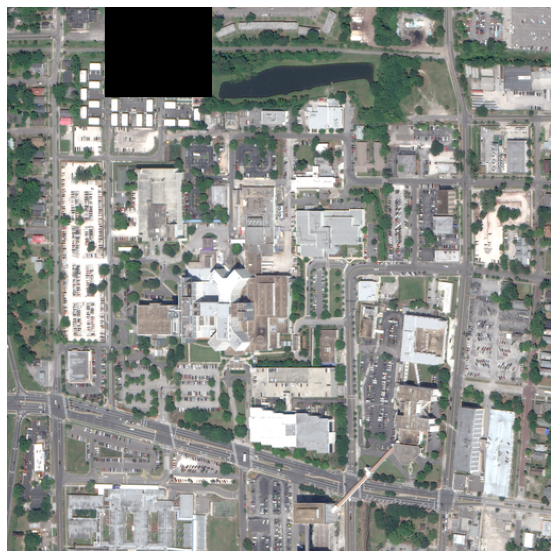

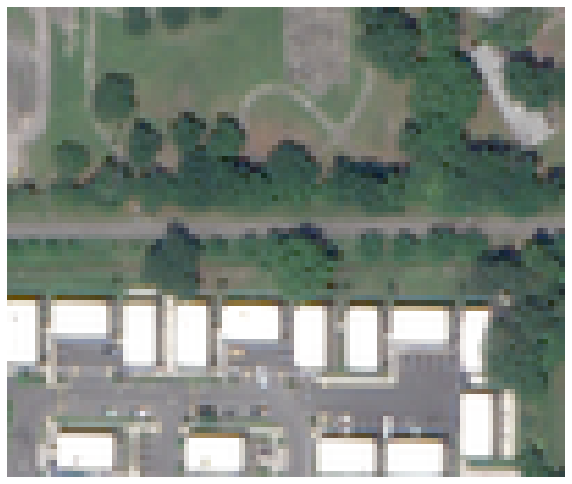

In [45]:
img_path = "/mnt/cdisk/roger/Datasets/DFC2019/Track3-RGB/JAX_068/JAX_068_015_RGB.tif"
img = Image.open(img_path).convert("RGB")
img = np.array(img.resize((512, 512), Image.LANCZOS))

i, j, patch_size = 34, 142, 101
rows = np.hstack([i-np.arange(1, patch_size//2 + 1)[::-1], i, i + np.arange(1, patch_size//2 + 1)])
cols = np.hstack([j-np.arange(1, patch_size//2 + 1)[::-1], j, j + np.arange(1, patch_size//2 + 1)])
rows = rows[rows >= 0]
cols = cols[cols >= 0]

cols_, rows_ = np.meshgrid(cols, rows)

print(img.shape)


rgbs = img[rows_, cols_, :]

print(rgbs.shape)

img[rows_, cols_, :] = 0

plt.figure(figsize=(10,10))
plt.imshow(img)
plt.axis('off')
plt.show()
plt.figure(figsize=(10,10))
plt.imshow(rgbs)
plt.axis('off')
plt.show()

In [97]:
rows_.ravel()

array([ 0,  0,  0, ..., 84, 84, 84])

In [98]:
cols_.ravel()

array([ 92,  93,  94, ..., 190, 191, 192])

In [101]:

print(tmp.shape)

(2, 4)


[ 0 51  1 52]


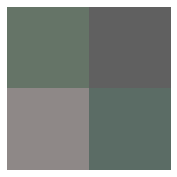

In [115]:
i, j = 0, 0
tmp = np.array([[i, j], [i+1, j], [i, j+1]]).T
out = np.ravel_multi_index(tmp, (patch_size, patch_size))

print(out)

plt.figure(figsize=(3,3))
plt.imshow(rgbs.reshape(-1, 3)[out].reshape(2,2, 3))
plt.axis('off')
plt.show()

In [94]:
overlap_ratio = 0.1
midrows = np.arange(patch_size//2, 512, np.floor(patch_size * (1 - overlap_ratio)))
midcols = np.arange(patch_size//2, 512, np.floor(patch_size * (1 - overlap_ratio)))
cols, rows = np.meshgrid(midcols, midrows)
window_centers = np.vstack([[0]* len(rows.ravel()), rows.ravel(), cols.ravel()]).T
print(window_centers.shape)

(169, 3)


25 25


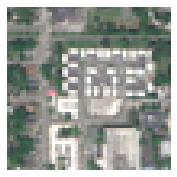

In [114]:
img_path = "/mnt/cdisk/roger/Datasets/DFC2019/Track3-RGB/JAX_068/JAX_068_015_RGB.tif"
img = Image.open(img_path).convert("RGB")
img = np.array(img.resize((128, 128), Image.LANCZOS))

patch_size = 51
plot= True

overlap_ratio = 0.2

for i in np.arange(patch_size//2, 512, np.floor(patch_size * (1 - overlap_ratio))).astype(int):
    for j in np.arange(patch_size//2, 512, np.floor(patch_size * (1 - overlap_ratio))).astype(int):
        rgbs = img[i-patch_size//2:i+patch_size//2+1, j-patch_size//2:j+patch_size//2+1, :]
        print(i, j)
        if plot:
            plt.figure(figsize=(3,3))
            plt.imshow(rgbs)
            plt.axis('off')
            plt.show()
            break
    if plot and i > 0:
        break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([1, 3, 100, 50, 5, 5])


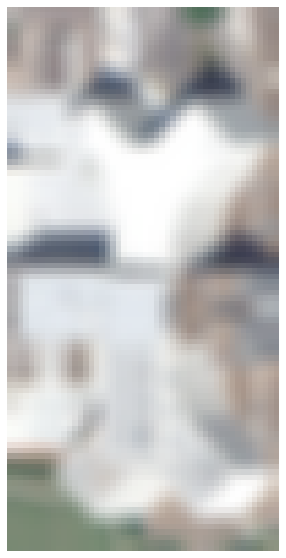

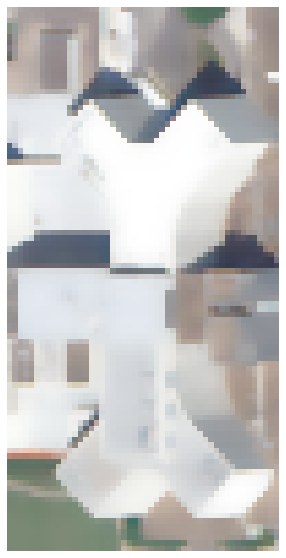

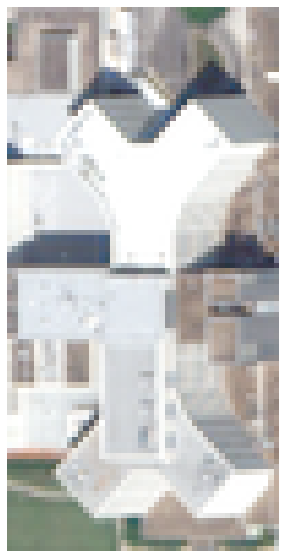

In [42]:
from torch import nn 
import torch.nn.functional as F 
from torchvision.transforms import ToTensor, ToPILImage
import torch
from PIL import Image

class GaussianFilter(nn.Module):
    def __init__(self, ksize=5, sigma=None):
        super(GaussianFilter, self).__init__()
        # initialize guassian kernel
        if sigma is None:
            sigma = 0.3 * ((ksize-1) / 2.0 - 1) + 0.8
        # Create a x, y coordinate grid of shape (kernel_size, kernel_size, 2)
        x_coord = torch.arange(ksize)
        x_grid = x_coord.repeat(ksize).view(ksize, ksize)
        y_grid = x_grid.t()
        xy_grid = torch.stack([x_grid, y_grid], dim=-1).float()

        # Calculate the 2-dimensional gaussian kernel
        center = ksize // 2
        weight = torch.exp(-torch.sum((xy_grid - center)**2., dim=-1) / (2*sigma**2))
        # Make sure sum of values in gaussian kernel equals 1.
        weight /= torch.sum(weight)
        self.gaussian_weight = weight

        # Reshape to 2d depthwise convolutional weight
        weight = weight.view(1, 1, ksize, ksize)
        weight = weight.repeat(3, 1, 1, 1)

        # create gaussian filter as convolutional layer
        pad = (ksize - 1) // 2
        self.filter = nn.Conv2d(3, 3, ksize, stride=1, padding=pad, groups=3, bias=False, padding_mode='reflect')
        self.filter.weight.data = weight
        self.filter.weight.requires_grad = False
    
    def forward(self, x):
        return self.filter(x)

class BilateralFilter(nn.Module):
    def __init__(self, ksize=5, sigma_space=None, sigma_density=None):
        super(BilateralFilter, self).__init__()
        # initialization
        if sigma_space is None:
            self.sigma_space = 0.3 * ((ksize-1) * 0.5 - 1) + 0.8
        else:
            self.sigma_space = sigma_space
        if sigma_density is None:
            self.sigma_density = self.sigma_space
        else:
            self.sigma_density = sigma_density

        self.pad = (ksize-1) // 2
        self.ksize = ksize
        # get the spatial gaussian weight
        self.weight_space = GaussianFilter(ksize=self.ksize, sigma=self.sigma_space).gaussian_weight

    def forward(self, x):
        # Extracts sliding local patches from a batched input tensor.
        x_pad = F.pad(x, pad=[self.pad, self.pad, self.pad, self.pad], mode='reflect')
        x_patches = x_pad.unfold(2, self.ksize, 1).unfold(3, self.ksize, 1)
        patch_dim = x_patches.dim()

        print(x_patches.shape)
        
        # Calculate the 2-dimensional gaussian kernel
        diff_density = x_patches - x.unsqueeze(-1).unsqueeze(-1)
        weight_density = torch.exp(-(diff_density ** 2) / (2 * self.sigma_density ** 2))
        # Normalization
        weight_density /= weight_density.sum(dim=(-1, -2), keepdim=True)

        # Keep same shape with weight_density
        weight_space_dim = (patch_dim - 2) * (1, ) + (self.ksize, self.ksize)
        weight_space = self.weight_space.view(*weight_space_dim).expand_as(weight_density)

        # get the final kernel weight
        weight = weight_density * weight_space
        weight_sum = weight.sum(dim=(-1, -2))
        x = (weight * x_patches).sum(dim=(-1, -2)) / weight_sum
        return x
    
img_path = "/mnt/cdisk/roger/Datasets/DFC2019/Track3-RGB/JAX_068/JAX_068_015_RGB.tif"
img_ = Image.open(img_path).convert("RGB")
img_ = np.array(img_.resize((512, 512), Image.LANCZOS))
img_ = img_[230:230+100, 180:180+50, :]
img = ToTensor()(img_).unsqueeze(0)

b_filter = BilateralFilter(ksize=5, sigma_space=2, sigma_density=0.1)
out_b = b_filter(img)
out_b = out_b.detach().squeeze(0).cpu()

g_filter = GaussianFilter(ksize=5, sigma=2)
out_g = g_filter(img)
out_g = out_g.detach().squeeze(0).cpu()

from torchvision.utils import save_image
#save_image(out_b, 'out_b.png')
#save_image(out_g, 'out_g.png')

plt.figure(figsize=(10,10))
plt.imshow(out_g.permute(1, 2, 0))
plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(out_b.permute(1, 2, 0))
plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(img_)
plt.axis('off')
plt.show()

torch.Size([1, 3, 512, 512]) torch.Size([1, 3, 512, 512])


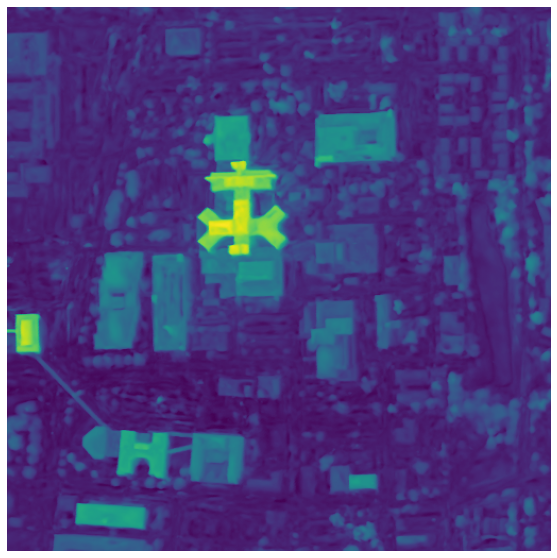

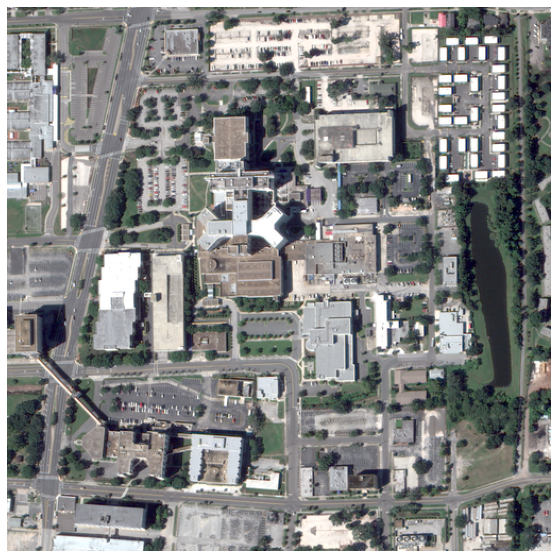

[[-22.533888 -22.19992  -22.280724 ... -21.93173  -21.806301 -21.687035]
 [-22.461102 -22.55056  -22.544683 ... -22.054552 -22.135038 -22.096012]
 [-22.465693 -22.398746 -22.385256 ... -22.045044 -22.138117 -22.596582]
 ...
 [-22.456615 -22.455149 -22.448332 ... -21.154663 -21.216309 -21.25759 ]
 [-22.519999 -22.51605  -22.506172 ... -20.892794 -20.97829  -21.014614]
 [-22.538612 -22.532885 -22.520092 ... -20.82887  -20.899815 -20.929264]]


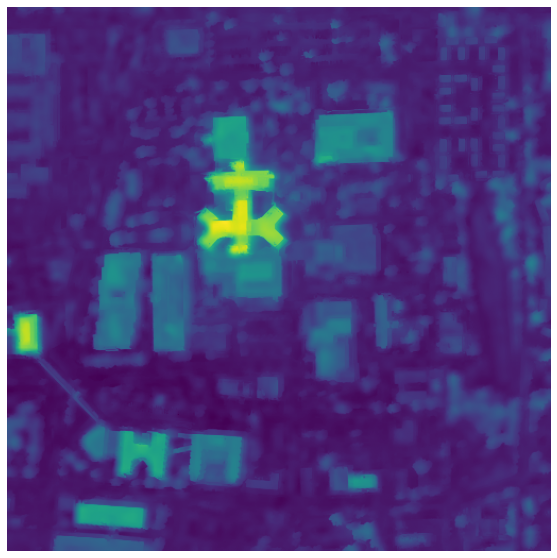

In [80]:
class GuidedBilateralFilter(nn.Module):
    def __init__(self, ksize=5, sigma_space=None, sigma_density=None):
        super(GuidedBilateralFilter, self).__init__()
        # initialization
        if sigma_space is None:
            self.sigma_space = 0.3 * ((ksize-1) * 0.5 - 1) + 0.8
        else:
            self.sigma_space = sigma_space
        if sigma_density is None:
            self.sigma_density = self.sigma_space
        else:
            self.sigma_density = sigma_density

        self.pad = (ksize-1) // 2
        self.ksize = ksize
        # get the spatial gaussian weight
        self.weight_space = GaussianFilter(ksize=self.ksize, sigma=self.sigma_space).gaussian_weight

    def forward(self, x, guide_img):
        # Extracts sliding local patches from a batched input tensor.
        x_pad = F.pad(guide_img, pad=[self.pad, self.pad, self.pad, self.pad], mode='reflect')
        x_patches = x_pad.unfold(2, self.ksize, 1).unfold(3, self.ksize, 1)
        patch_dim = x_patches.dim()
        
        # Calculate the 2-dimensional gaussian kernel
        diff_density = x_patches - guide_img.unsqueeze(-1).unsqueeze(-1)
        weight_density = torch.exp(-(diff_density ** 2) / (2 * self.sigma_density ** 2))
        # Normalization
        weight_density /= weight_density.sum(dim=(-1, -2), keepdim=True)

        # Keep same shape with weight_density
        weight_space_dim = (patch_dim - 2) * (1, ) + (self.ksize, self.ksize)
        weight_space = self.weight_space.view(*weight_space_dim).expand_as(weight_density)

        # get the final kernel weight
        weight = weight_density * weight_space
        weight_sum = weight.sum(dim=(-1, -2))
        x_pad = F.pad(x, pad=[self.pad, self.pad, self.pad, self.pad], mode='reflect')
        x_patches = x_pad.unfold(2, self.ksize, 1).unfold(3, self.ksize, 1)
        x = (weight * x_patches).sum(dim=(-1, -2)) / weight_sum
        return x



pred_depth_path = "/mnt/cdisk/roger/nerf_output/logs/2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5/val/depth/JAX_068_002_RGB_epoch68.tif"
gt_img_path = "/mnt/cdisk/roger/nerf_output/logs/2021-12-07_21-28-03_JAX_068_512_satnerf_uncertintyx0.5/val/gt_rgb/JAX_068_002_RGB_epoch68.tif"

img_ = Image.open(pred_depth_path)
img_ = np.array(img_.resize((512, 512), Image.LANCZOS))
img = ToTensor()(img_).unsqueeze(0)
img = torch.cat([img, img, img], 1)

with rasterio.open(gt_img_path, 'r') as f:
    guide_ = np.transpose(f.read(), (1, 2, 0))
    guide_ = Image.fromarray((guide_*255).astype(np.uint8))
guide_ = np.array(guide_.resize((512, 512), Image.LANCZOS))
guide = ToTensor()(guide_).unsqueeze(0)

b_filter = GuidedBilateralFilter(ksize=9, sigma_space=7, sigma_density=0.2)
out_b = b_filter(img, guide)
out_b = out_b.detach().squeeze(0).cpu().numpy()

plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(img_))
plt.axis('off')
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(guide_)
plt.axis('off')
plt.show()

out_b = out_b[0, :, :]
plt.figure(figsize=(10,10))
plt.imshow(visualize_depth(out_b))
plt.axis('off')
plt.show()

In [91]:
out_b.shape

(512, 512)

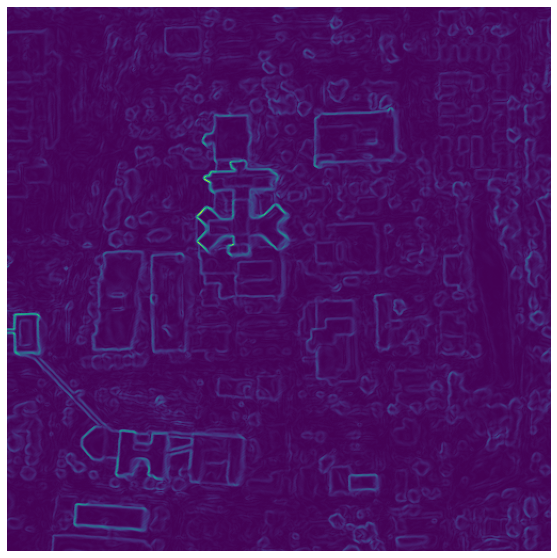

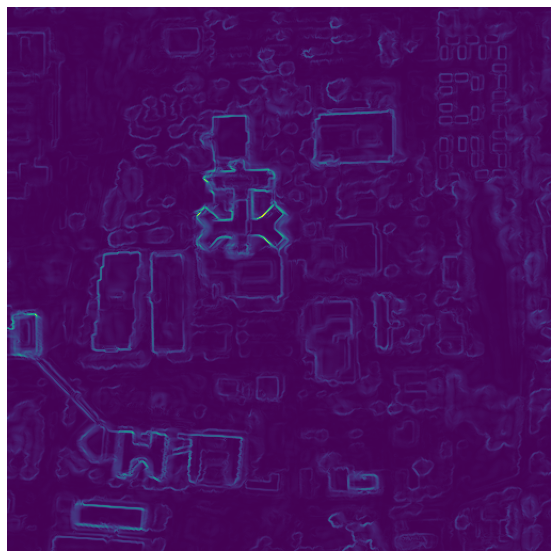

In [99]:
class CustomFilter(torch.nn.Module):

    def __init__(self, kernel_x, kernel_y):
        super(CustomFilter, self).__init__()
        self.conv_x = torch.nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=0, bias=False)
        self.conv_x.weight = torch.nn.Parameter(torch.from_numpy(kernel_x).double().unsqueeze(0).unsqueeze(0))
        self.conv_y = torch.nn.Conv2d(1, 1, kernel_size=3, stride=1, padding=0, bias=False)
        self.conv_y.weight = torch.nn.Parameter(torch.from_numpy(kernel_y).double().unsqueeze(0).unsqueeze(0))

    def forward(self, tensor):
        input_g_x = self.conv_x(tensor)
        input_g_y = self.conv_y(tensor)
        return input_g_x[:,:,1:-1,:], input_g_y[:,:,:,1:-1]
    
kernel_x = np.array([[1 / 2, 0, -1 / 2]])
kernel_y = kernel_x.T
gradient_filter = CustomFilter(kernel_x, kernel_y)

img_ = Image.open(pred_depth_path)
img_ = np.array(img_.resize((512, 512), Image.LANCZOS))
img = ToTensor()(img_).unsqueeze(0)
img_bilateral = torch.from_numpy(out_b).reshape(1, 1, 512, 512)

gradients = []
for im in [img, img_bilateral]:
    dx, dy = gradient_filter(im.double())
    dx = dx.detach().squeeze(0).cpu().numpy()
    dy = dy.detach().squeeze(0).cpu().numpy()
    grad = abs(dx[0, :, :]) + abs(dy[0, : ,:])
    gradients.append(grad)
    
    plt.figure(figsize=(10,10))
    plt.imshow(grad)
    plt.axis('off')
    plt.show()
    
plt.figure(figsize=(10,10))
plt.imshow(abs(gradients[0] - gradients[1]))
plt.axis('off')
plt.show() 

    

012716_
041916_
042616_
050116_
050216_
052116_
061516_
070516_
101115_
101816_
103015_
110116_
121416_
122716_


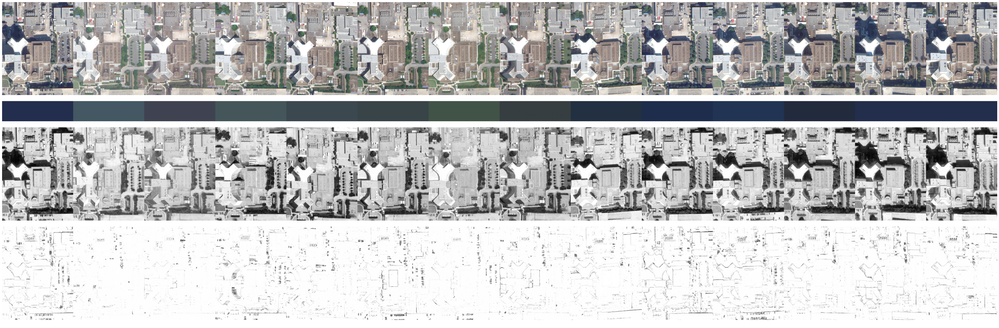

'\n\nimg_window = np.array([30, 1300, 600, 500]) //4\n\nimg_size = 512\n\nim = []\nfor p in img_paths:\n    if os.path.basename(p) not in files_to_ignore:\n        row0, col0, h, w = img_window\n        with rasterio.open(p, \'r\') as f:\n            img = np.transpose(f.read(), (1, 2, 0))\n        if img.shape[0] != img_size:\n            img = Image.fromarray(img)\n            img = img.resize((img_size, img_size), Image.LANCZOS)\n            img = np.array(img) / 255.\n        im.append(img[row0:row0+h, col0:col0+w])\n        im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))\nim = np.hstack(im)\n\nplt.figure(figsize=(80,10))\nplt.imshow(im)\nplt.axis("off")\nplt.show()\n\n'

In [1206]:
#### sort by date

import glob
from PIL import Image

img_paths = sorted(glob.glob("/mnt/cdisk/roger/nerf_output/results/JAX_068_ordered_by_date/*.tif"))
img_window = np.array([800, 670, 600, 500]) //4

img_size = 512


results_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/eval_aoi/2022-02-22_19-01-03_o_JAX_068_full_snerf_beta_SCx0.1_1st_iters_2ndepoch"

files_to_ignore = ["012116_JAX_068_009_RGB.tif", "012116_JAX_068_010_RGB.tif",
                   "100516_JAX_068_001_RGB.tif", "100516_JAX_068_002_RGB.tif", "021516_JAX_068_012_RGB.tif"]

def get_id(fname):
    return os.path.splitext(os.path.basename(fname))[0]

def resize_rgb(img, h, w):
    img = Image.fromarray(img)
    img = img.resize((img_size, img_size), Image.LANCZOS)
    return np.array(img)

row0, col0, h, w = img_window
im = []
for p in img_paths:
    if os.path.basename(p) not in files_to_ignore:
        
        print(get_id(p)[:7])
        
        rgb_path = glob.glob(os.path.join(results_dir, "train/gt_rgb", get_id(p)[7:] + "*.tif"))[0]
        sky_path = glob.glob(os.path.join(results_dir, "train/sky", get_id(p)[7:] + "*.tif"))[0]
        sun_path = glob.glob(os.path.join(results_dir, "train/sun", get_id(p)[7:] + "*.tif"))[0]
        beta_path = glob.glob(os.path.join(results_dir, "train/beta", get_id(p)[7:] + "*.tif"))[0]
        
        # read rgb
        with rasterio.open(rgb_path, 'r') as f:
            tmp = np.transpose(f.read(), (1, 2, 0))
        tmp = resize_rgb((tmp*255).astype(np.uint8), 830, 830)
        img = tmp[50:720, 60:-100, :]
        img = np.vstack([img, 255*np.ones((30, img.shape[1], 3))])
        
        # read sky
        with rasterio.open(sky_path, 'r') as f:
            tmp = np.transpose(f.read(), (1, 2, 0))
        tmp = resize_rgb((tmp*255).astype(np.uint8), 830, 830)
        img = np.vstack([img, tmp[:100, 60:-100, :]])
        img = np.vstack([img, 255*np.ones((30, img.shape[1], 3))])

        # read sun
        with rasterio.open(sun_path, 'r') as f:
            tmp = np.transpose(f.read(), (1, 2, 0))
            tmp = np.dstack([tmp, tmp, tmp])
        tmp = resize_rgb((tmp*255).astype(np.uint8), 830, 830)
        img = np.vstack([img, tmp[50:720, 60:-100, :]])
        img = np.vstack([img, 255*np.ones((30, img.shape[1], 3))])

        # read sun
        with rasterio.open(beta_path, 'r') as f:
            tmp = 1 - np.transpose(f.read(), (1, 2, 0))*4
            tmp = np.dstack([tmp, tmp, tmp])
        tmp = resize_rgb((tmp*255).astype(np.uint8), 830, 830)
        img = np.vstack([img, tmp[50:720, 60:-100, :]])
        img = np.vstack([img, 255*np.ones((30, img.shape[1], 3))])

        im.append(img/255)
        #plt.figure(figsize=(10, 10))
        #plt.imshow(img)
        #plt.show()
        
im = np.hstack(im)
plt.figure(figsize=(120,20))
plt.imshow(im)
plt.axis("off")
plt.show()

"""

img_window = np.array([30, 1300, 600, 500]) //4

img_size = 512

im = []
for p in img_paths:
    if os.path.basename(p) not in files_to_ignore:
        row0, col0, h, w = img_window
        with rasterio.open(p, 'r') as f:
            img = np.transpose(f.read(), (1, 2, 0))
        if img.shape[0] != img_size:
            img = Image.fromarray(img)
            img = img.resize((img_size, img_size), Image.LANCZOS)
            img = np.array(img) / 255.
        im.append(img[row0:row0+h, col0:col0+w])
        im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im)

plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

"""


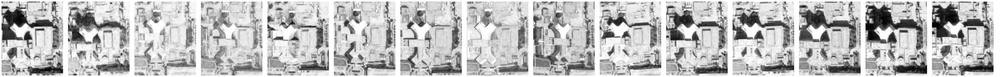

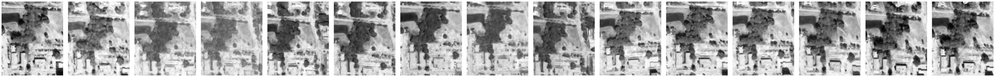

In [232]:
img_paths = glob.glob("/mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-22_04-05-38_JAX_068_512_snerf_/*/sun/*.tif")

img_ids = ["JAX_068_011_RGB", "JAX_068_012_RGB", "JAX_068_013_RGB",
           "JAX_068_014_RGB", "JAX_068_015_RGB", "JAX_068_016_RGB", "JAX_068_018_RGB", "JAX_068_019_RGB",
           "JAX_068_020_RGB", "JAX_068_003_RGB", "JAX_068_004_RGB",
           "JAX_068_005_RGB", "JAX_068_022_RGB", "JAX_068_006_RGB", "JAX_068_007_RGB"]

img_window = np.array([800, 670, 600, 500]) //4

im = []
for img_id in img_ids:
    for p in img_paths:
        if img_id in p:
            row0, col0, h, w = img_window
            with rasterio.open(p, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
            if img.shape[2] == 1:
                img = np.dstack([img, img, img])
            if img.shape[0] != img_size:
                img = Image.fromarray(img)
                img = img.resize((img_size, img_size), Image.LANCZOS)
                img = np.array(img) / 255.
            im.append(img[row0:row0+h, col0:col0+w])
            im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im)

plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

img_window = np.array([30, 1300, 600, 500]) //4

im = []
for img_id in img_ids:
    for p in img_paths:
        if img_id in p:
            row0, col0, h, w = img_window
            with rasterio.open(p, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
            if img.shape[2] == 1:
                img = np.dstack([img, img, img])
            if img.shape[0] != img_size:
                img = Image.fromarray(img)
                img = img.resize((img_size, img_size), Image.LANCZOS)
                img = np.array(img) / 255.
            im.append(img[row0:row0+h, col0:col0+w])
            im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im)

plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

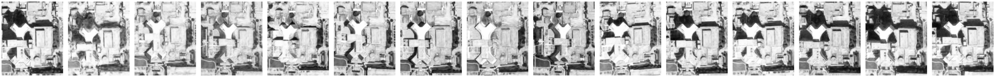

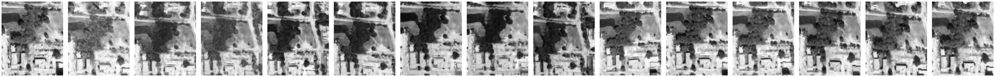

In [234]:
img_paths = glob.glob("/mnt/cdisk/roger/nerf_output/results_cvprw/eval_aoi/2022-01-28_19-24-03_JAX_068_512_snerf_SCx0.05_/*/sun/*.tif")

img_ids = ["JAX_068_011_RGB", "JAX_068_012_RGB", "JAX_068_013_RGB",
           "JAX_068_014_RGB", "JAX_068_015_RGB", "JAX_068_016_RGB", "JAX_068_018_RGB", "JAX_068_019_RGB",
           "JAX_068_020_RGB", "JAX_068_003_RGB", "JAX_068_004_RGB",
           "JAX_068_005_RGB", "JAX_068_022_RGB", "JAX_068_006_RGB", "JAX_068_007_RGB"]

img_window = np.array([800, 670, 600, 500]) //4

im = []
for img_id in img_ids:
    for p in img_paths:
        if img_id in p:
            row0, col0, h, w = img_window
            with rasterio.open(p, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
            if img.shape[2] == 1:
                img = np.dstack([img, img, img])
            if img.shape[0] != img_size:
                img = Image.fromarray(img)
                img = img.resize((img_size, img_size), Image.LANCZOS)
                img = np.array(img) / 255.
            im.append(img[row0:row0+h, col0:col0+w])
            im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im)

plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

img_window = np.array([30, 1300, 600, 500]) //4

im = []
for img_id in img_ids:
    for p in img_paths:
        if img_id in p:
            row0, col0, h, w = img_window
            with rasterio.open(p, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
            if img.shape[2] == 1:
                img = np.dstack([img, img, img])
            if img.shape[0] != img_size:
                img = Image.fromarray(img)
                img = img.resize((img_size, img_size), Image.LANCZOS)
                img = np.array(img) / 255.
            im.append(img[row0:row0+h, col0:col0+w])
            im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))
im = np.hstack(im)

plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

### NeRF vs S2P evaluation

min height -26.95, max height 58.43


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


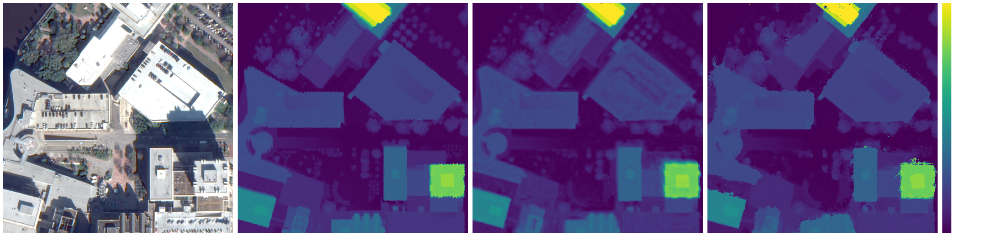

In [1209]:
def visualize_depth(depth, cmap=cv2.COLORMAP_JET, clip=False, mi=None, ma=None):
    
    cmap = cv2.COLORMAP_VIRIDIS
    """
    depth: (H, W)
    """
    x = depth
    #x = np.nan_to_num(x) # change nan to 0
    if mi is None:
        mi = np.nanmin(x) if not clip else np.nanpercentile(x, 1) # get minimum depth
    if ma is None:
        ma = np.nanmax(x) if not clip else np.nanpercentile(x, 90)
    x = (x-mi)/(ma-mi) # normalize to 0~1
    x = np.clip(x, 0, 1)
    x = (255.*x).astype(np.uint8)
    x = np.clip(x, 0, 255)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    x_ = x_ / 255.
    return x_



aoi_id = "JAX_214"

if aoi_id == "JAX_004":
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-19_17-26-18_o_JAX_004_full_snerf_beta_SCx0.1"
    ref_rgb = os.path.join(nerf_dsm_dir, "ref_rgb.tif")
    gt_dsm = glob.glob(os.path.join(nerf_dsm_dir, "tmp_gt_*.tif"))[0]
    nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch44_*.tif"))[0]
    s2p_pan_dsm = glob.glob(f"/mnt/cdisk/roger/s2p_dsms/PAN/{aoi_id}_ba_v2_PAN/rmvs_med_*.tif")[0]
    p_b, p_t = 0, 90
elif aoi_id == "JAX_068":
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-22_19-01-03_o_JAX_068_full_snerf_beta_SCx0.1_1st_iters_2ndepoch"
    ref_rgb = os.path.join(nerf_dsm_dir, "ref_rgb.tif")
    gt_dsm = glob.glob(os.path.join(nerf_dsm_dir, "tmp_gt_*.tif"))[0]
    nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch25_*.tif"))[0]
    s2p_pan_dsm = glob.glob(f"/mnt/cdisk/roger/s2p_dsms/PAN/{aoi_id}_ba_v2_PAN/rmvs_med_*.tif")[0]
    p_b, p_t = 0, 99
elif aoi_id == "JAX_214":
    #nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops2/results/pretty_dsm/2022-02-18_17-55-32_o_JAX_214_full_snerf_beta_DSx1000"
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-19_17-26-18_o_JAX_214_full_snerf_beta_DS"
    ref_rgb = os.path.join(nerf_dsm_dir, "ref_rgb.tif")
    gt_dsm = glob.glob(os.path.join(nerf_dsm_dir, "tmp_gt_*.tif"))[0]
    #nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch15_*.tif"))[0]
    nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch24_*.tif"))[0]
    s2p_pan_dsm = glob.glob(f"/mnt/cdisk/roger/s2p_dsms/PAN/{aoi_id}_ba_v2_PAN/rmvs_med_*.tif")[0]
    p_b, p_t = 1, 99.2
elif aoi_id == "JAX_260":
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-19_17-26-20_o_JAX_260_full_snerf_beta_DS"
    ref_rgb = os.path.join(nerf_dsm_dir, "ref_rgb.tif")
    gt_dsm = glob.glob(os.path.join(nerf_dsm_dir, "tmp_gt_*.tif"))[0]
    nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch28_*.tif"))[0]
    s2p_pan_dsm = glob.glob(f"/mnt/cdisk/roger/s2p_dsms/PAN/{aoi_id}_ba_v2_PAN/rmvs_med_*.tif")[0]
    p_b, p_t = 0, 99.9
else:
    print("aoi_id is not valid!!!")

dsm_paths = [ref_rgb, gt_dsm, nerf_dsm, s2p_pan_dsm]

im = []
for t, p in enumerate(dsm_paths):
    with rasterio.open(p, 'r') as f:
        img = np.transpose(f.read(), (1, 2, 0))
    if t == 1:
        mi = np.nanpercentile(img, p_b) #np.nanmin(img)
        ma = np.nanpercentile(img, p_t) #004 [0, 90], 068 [0, 99] 214 [1, 99.2]
        print("min height {:.2f}, max height {:.2f}".format(mi, ma))
    if img.shape[2] == 1:
        img = img[:512, :512, :]
        nans = img == np.nan
        nans = nans[:, :, 0]
        img[nans] = np.nanmin(img)
        img = visualize_depth(img, mi=mi, ma=ma)
        img[nans, :] = np.nan
    if img.shape[0] != img_size:
        mi, ma = np.nanmin(img), np.nanmax(img)
        if mi != 0 or ma != 255:
            x = (img-mi)/(ma-mi) # normalize to 0~1
            x = np.clip(x, 0, 1)
            x = (255.*x).astype(np.uint8)
            img = x
        img = Image.fromarray(img)
        img = img.resize((img_size, img_size), Image.LANCZOS)
        img = np.array(img) / 255.
    m = 6
    img = img[m:-m, m:-m, :] 
    im.append(img)
    im.append(np.ones((im[-1].shape[0], 10, 3), dtype=np.int32))

    if t == len(dsm_paths) - 1:
        cmap_img = create_cmap_img(img.shape[0], 20, cmap=cv2.COLORMAP_VIRIDIS)/255
        #white = 255*np.ones((img.shape[0], 20, 3), dtype=np.int32)
        #cmap_img = np.hstack([white, cmap_img, white])/255
        im.append(cmap_img)
        im.append(255*np.ones((im[-1].shape[0], 5*20, 3), dtype=np.int32))
    
im = np.hstack(im)



plt.figure(figsize=(80,10))
plt.imshow(im)
plt.axis("off")
plt.show()

### Illustrate the advantages of beta for geometry learning

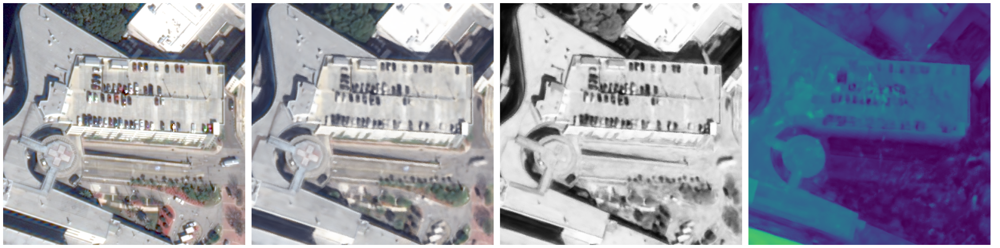

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


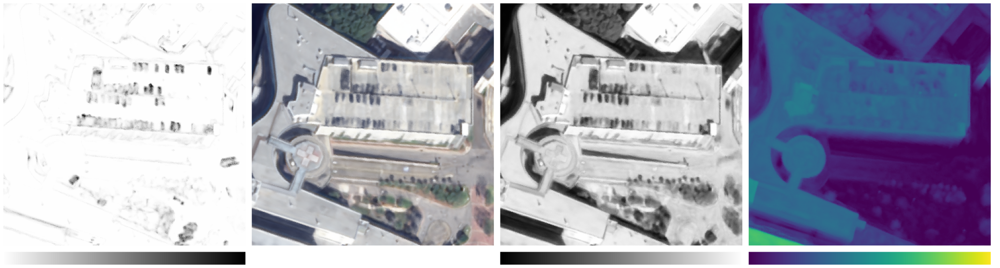

In [1041]:
def visualize_depth(depth, cmap=cv2.COLORMAP_JET, clip=False, mi=None, ma=None):
    
    cmap = cv2.COLORMAP_VIRIDIS
    """
    depth: (H, W)
    """
    x = depth
    #x = np.nan_to_num(x) # change nan to 0
    if mi is None:
        mi = np.nanmin(x) if not clip else np.nanpercentile(x, 1) # get minimum depth
    if ma is None:
        ma = np.nanmax(x) if not clip else np.nanpercentile(x, 90)
    x = (x-mi)/(ma-mi) # normalize to 0~1
    x = np.clip(x, 0, 1)
    x = (255.*x).astype(np.uint8)
    x = np.clip(x, 0, 255)
    x_ = cv2.applyColorMap(x, cmap)
    x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
    x_ = x_ / 255.
    return x_

def create_cmap_img(h, w, cmap=cv2.COLORMAP_VIRIDIS):
    x = np.hstack([np.linspace(0, 1, h).reshape(-1, 1)[::-1] for i in range(w)])
    x = (255*x).astype(np.uint8)
    if cmap is None:
        return np.dstack([x, x, x])
    else:
        x_ = cv2.applyColorMap(x, cmap)
        x_ = cv2.cvtColor(x_, cv2.COLOR_BGR2RGB)
        return x_

aoi_id = "JAX_214_ex1"

if aoi_id == "JAX_214_ex1":
    dir_nobeta = "/mnt/cdisk/roger/nerf_output-crops3/results/eval_aoi/2022-02-19_17-26-18_JAX_214_full_snerf_SCx0.05/train"
    dir_beta = "/mnt/cdisk/roger/nerf_output-crops3/results/eval_aoi/2022-02-19_17-26-19_o_JAX_214_full_snerf_beta_SCx0.1/train"
    img_bn = "JAX_214_025_RGB_epoch20.tif"
    mi, ma = -26.9, 58.4
    row0, col0, rows, cols = 220, 0, 380, 380
else:
    print("error!")

to_display = ["gt_rgb", "rgb", "sun", "depth", "beta"]
for d_idx, d in enumerate([dir_nobeta, dir_beta]):
    im = []
    for k in to_display:
        if k == "beta" and "beta" not in d:
            #img = np.ones((rows, cols, 3))
            continue
        elif k == "gt_rgb" and "beta" in d:
            continue
        else:
            img_path = os.path.join(d, k, img_bn)
            with rasterio.open(img_path, 'r') as f:
                img = np.transpose(f.read(), (1, 2, 0))
            if img.shape[2] == 1:
                if k == "depth":
                    nans = img == np.nan
                    nans = nans[:, :, 0]
                    img[nans] = np.nanmin(img)
                    img = visualize_depth(img, mi=-27, ma=30)
                    img[nans, :] = np.nan
                elif k == "sun":
                    img = np.dstack([img[:, :, 0], img[:, :, 0], img[:, :, 0]])
                    img[0, 0, :] = 1.
                    img[-1, -1, :] = 0.
                else:
                    img = np.dstack([img[:, :, 0], img[:, :, 0], img[:, :, 0]])
                    img[0, 0, :] = 1.
                    img[-1, -1, :] = 0.
                    img = 1- img
            img = img[row0:row0+rows, col0:col0+cols, :]
        if d_idx == 1:
            # add colorbars
            white = np.ones((10, img.shape[1], 3), dtype=np.int32)
            if k == "depth":
                cmap_img = create_cmap_img(img.shape[1], 20, cmap=cv2.COLORMAP_VIRIDIS)/255
                cmap_img = np.rot90(cmap_img, k=3)
            elif k == "sun":
                cmap_img = create_cmap_img(img.shape[1], 20, cmap=None)/255
                cmap_img = np.rot90(cmap_img, k=3)
            elif k == "beta":
                cmap_img = create_cmap_img(img.shape[1], 20, cmap=None)/255
                cmap_img = np.fliplr(np.rot90(cmap_img, k=3))
            else:
                cmap_img = np.ones((20, img.shape[1], 3))
            img = np.vstack([img, white, cmap_img])
        white = np.ones((img.shape[0], 10, 3), dtype=np.int32)
        if k == "beta":
            im = [img, white] + im
        else:
            im.append(img)
            im.append(white)

    im = np.hstack(im)
    plt.figure(figsize=(80,10))
    plt.imshow(im)
    plt.axis("off")
    plt.show()

(262144, 3)
(226458, 3)


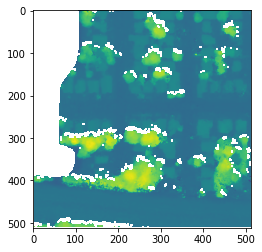

MAE: 1.395


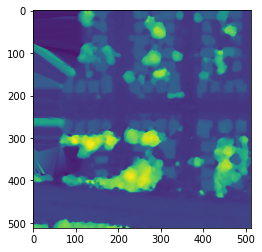

In [1238]:
import datetime
from osgeo import gdal
import shutil

def dsm_pointwise_abs_errors(in_dsm_path, gt_dsm_path, dsm_metadata, gt_mask_path=None, out_rdsm_path=None, out_err_path=None):
    """
    in_dsm_path is a string with the path to the NeRF generated dsm
    gt_dsm_path is a string with the path to the reference lidar dsm
    bbx_metadata is a 4-valued array with format (x, y, s, r)
    where [x, y] = offset of the dsm bbx, s = width = height, r = resolution (m per pixel)
    """

    unique_identifier = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
    pred_dsm_path = "tmp_crop_dsm_to_delete_{}.tif".format(unique_identifier)
    pred_rdsm_path = "tmp_crop_rdsm_to_delete_{}.tif".format(unique_identifier)

    # read dsm metadata
    xoff, yoff = dsm_metadata[0], dsm_metadata[1]
    xsize, ysize = int(dsm_metadata[2]), int(dsm_metadata[2])
    resolution = dsm_metadata[3]

    # define projwin for gdal translate
    ulx, uly, lrx, lry = xoff, yoff + ysize * resolution, xoff + xsize * resolution, yoff

    # crop predicted dsm using gdal translate
    ds = gdal.Open(in_dsm_path)
    ds = gdal.Translate(pred_dsm_path, ds, projWin=[ulx, uly, lrx, lry])
    ds = None
    # os.system("gdal_translate -projwin {} {} {} {} {} {}".format(ulx, uly, lrx, lry, source_path, crop_path))
    if gt_mask_path is not None:
        with rasterio.open(gt_mask_path, "r") as f:
            mask = f.read()[0, :, :]
            water_mask = mask.copy()
            water_mask[mask != 9] = 0
            water_mask[mask == 9] = 1
        with rasterio.open(pred_dsm_path, "r") as f:
            profile = f.profile
            pred_dsm = f.read()[0, :, :]
        with rasterio.open(pred_dsm_path, 'w', **profile) as dst:
            pred_dsm[water_mask.astype(bool)] = np.nan
            dst.write(pred_dsm, 1)
        """
        tmp_gt_path = os.path.join(os.path.dirname(out_rdsm_path), "tmp_gt_{}.tif".format(unique_identifier))
        with rasterio.open(gt_dsm_path, "r") as f:
            gt_dsm = f.read()[0, :, :]
        with rasterio.open(tmp_gt_path, 'w', **profile) as dst:
            gt_dsm[water_mask.astype(bool)] = np.nan
            dst.write(gt_dsm, 1)
        gt_dsm_path = tmp_gt_path
        """

    # read predicted and gt dsms
    with rasterio.open(gt_dsm_path, "r") as f:
        gt_dsm = f.read()[0, :, :]
        kwds = f.profile
    with rasterio.open(pred_dsm_path, "r") as f:
        profile = f.profile
        pred_dsm = f.read()[0, :, :]

    # register and compute mae
    fix_xy = False
    try:
        import dsmr
    except:
        print("Warning: dsmr not found ! DSM registration will only use the Z dimension")
        fix_xy = True
    if fix_xy:
        pred_rdsm = pred_dsm + np.nanmean((gt_dsm - pred_dsm).ravel())
        with rasterio.open(pred_rdsm_path, 'w', **profile) as dst:
            dst.write(pred_rdsm, 1)
    else:
        import dsmr
        transform = dsmr.compute_shift(gt_dsm_path, pred_dsm_path, scaling=False)
        dsmr.apply_shift(pred_dsm_path, pred_rdsm_path, *transform)
        with rasterio.open(pred_rdsm_path, "r") as f:
            pred_rdsm = f.read()[0, :, :]
    abs_err = pred_rdsm - gt_dsm

    # remove tmp files and write output tifs if desired
    os.remove(pred_dsm_path)
    if out_rdsm_path is not None:
        if os.path.exists(out_rdsm_path):
            os.remove(out_rdsm_path)
        os.makedirs(os.path.dirname(out_rdsm_path), exist_ok=True)
        shutil.copyfile(pred_rdsm_path, out_rdsm_path)
    os.remove(pred_rdsm_path)
    if out_err_path is not None:
        if os.path.exists(out_err_path):
            os.remove(out_err_path)
        os.makedirs(os.path.dirname(out_err_path), exist_ok=True)
        with rasterio.open(out_err_path, 'w', **profile) as dst:
            dst.write(abs_err, 1)

    return abs(abs_err)



def interpolate_image(_im_np, method='cubic'):
    
    import scipy.ndimage
    import scipy.spatial
    import scipy.interpolate
    import scipy.signal
    import skimage.draw
    
    # 'nearest', 'linear', 'cubic'
    im_np = _im_np.copy()
    undefined_areas_np = np.isnan(im_np)
    defined_areas_np = np.logical_not(undefined_areas_np)
    defined_areas_np = defined_areas_np ^ scipy.ndimage.binary_erosion(defined_areas_np)

    (y, x) = np.where(defined_areas_np)
    z = im_np[y, x]

    if (method != 'nearest'):
        hull = scipy.spatial.ConvexHull(np.array([y, x]).transpose())
        mask_np = np.ones(im_np.shape, dtype=bool)

        rr, cc = skimage.draw.polygon(y[hull.vertices], x[hull.vertices])
        mask_np[rr, cc] = False
        nearest_np = interpolate_image(im_np, method='nearest')

        im_np[mask_np] = nearest_np[mask_np]

        undefined_areas_np = np.isnan(im_np)
        defined_areas_np = np.logical_not(undefined_areas_np)
        defined_areas_np = defined_areas_np ^ scipy.ndimage.binary_erosion(defined_areas_np)

        (y, x) = np.where(defined_areas_np)
        z = im_np[y, x]

    X = np.zeros((z.shape[0], 2))
    X[:, 0] = x
    X[:, 1] = y

    (to_y, to_x) = np.where(undefined_areas_np)
    method_i = 0
    to_z = scipy.interpolate.griddata(X, z, (to_x, to_y), method=method)
    im_np[to_y, to_x] = to_z

    if (np.max(np.isnan(im_np)) == 1):
        print('fail')
        im_np = interpolate_image(im_np, method='nearest')
    return im_np 

def write_point_cloud_ply(filename, point_cloud, color=np.array([None, None, None])):
    """
    Writes a point cloud of N 3d points to a ply file
    The color of the points can be specified using color (3 valued vector with the rgb values)
    """
    with open(filename, "w") as f_out:
        n_points = point_cloud.shape[0]
        # write output ply file with the point cloud
        f_out.write("ply\n")
        f_out.write("format ascii 1.0\n")
        f_out.write("element vertex {}\n".format(n_points))
        f_out.write("property float x\nproperty float y\nproperty float z\n")
        if not (color[0] is None and color[1] is None and color[2] is None):
            f_out.write("property uchar red\nproperty uchar green\nproperty uchar blue\nproperty uchar alpha\n")
            f_out.write("element face 0\nproperty list uchar int vertex_indices\n")
        f_out.write("end_header\n")
        # write 3d points
        for i in range(n_points):
            p_3d = point_cloud[i, :]
            f_out.write("{} {} {}".format(p_3d[0], p_3d[1], p_3d[2]))
            if not (color[0] is None and color[1] is None and color[2] is None):
                f_out.write(" {} {} {} 255".format(color[0], color[1], color[2]))
            f_out.write("\n")


aoi_id = "JAX_004"

if aoi_id == "JAX_068":
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-22_19-01-03_o_JAX_068_full_snerf_beta_SCx0.1_1st_iters_2ndepoch"
elif aoi_id == "JAX_004":
    nerf_dsm_dir = "/mnt/cdisk/roger/nerf_output-crops3/results/pretty_dsm/2022-02-19_17-26-18_o_JAX_004_full_snerf_beta_SCx0.1"
else:
    print("unknown AOI!")
nerf_dsm = glob.glob(os.path.join(nerf_dsm_dir, "rdsm_epoch*.tif"))[0]
s2p_pan_dsm = glob.glob(f"/mnt/cdisk/roger/s2p_dsms/PAN/{aoi_id}_ba_v2_PAN/rmvs_med_dsm_*BEST.tif")[0]
gt_dsm = glob.glob(os.path.join(nerf_dsm_dir, "tmp_gt_*.tif"))[0]

gt_dsm2 = f"/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/{aoi_id}_DSM.tif"
dsm_metadata=np.loadtxt(f"/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/{aoi_id}_DSM.txt")
if aoi_id in ["JAX_004", "JAX_260"]:
    gt_seg_path = f"/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/{aoi_id}_CLS_v2.tif"
else:
    gt_seg_path = f"/mnt/cdisk/roger/Datasets/DFC2019/Track3-Truth/{aoi_id}_CLS.tif"


input_dsm = nerf_dsm
input_dsm = s2p_pan_dsm
#input_dsm = gt_dsm

with rasterio.open(input_dsm, "r") as src:
    alts = src.read(1)[:512, :512]
    kwds = src.profile
rows, cols = alts.shape
cols_, rows_ = np.meshgrid(np.arange(cols), np.arange(rows))

cloud = np.vstack([cols_.ravel(), rows_.ravel(), alts.ravel()]).T
print(cloud.shape)
cloud = cloud[~np.isnan(np.sum(cloud, axis=1))]
print(cloud.shape)

write_point_cloud_ply("/home/roger/PycharmProjects/satnerf/test.ply", cloud)


plt.figure()
plt.imshow(alts)
plt.show()

if True: #"PAN" in input_dsm:
    from scipy.ndimage import median_filter, generic_filter
    alts = generic_filter(alts, np.nanmedian, size=7)
    
    """
    ue = dsm_pointwise_abs_errors(input_dsm, gt_dsm2, dsm_metadata, gt_mask_path=gt_seg_path)
    with rasterio.open(gt_dsm, "r") as src:
        gt_alts = src.read(1)
        print("MAE: {:.3f}".format(np.nanmean(ue.flatten())))# np.nanmean(abs(alts - gt_alts).flatten())))
    """
    with rasterio.open(gt_dsm, "r") as src:
        gt_alts = src.read(1)
        print("MAE: {:.3f}".format(np.nanmean(abs(alts - gt_alts).flatten())))

alts_int = interpolate_image(alts, method='linear')

plt.figure()
plt.imshow(alts_int)
plt.show()

with rasterio.open("/home/roger/PycharmProjects/satnerf/test_geotiff.tif", "w", **kwds) as dst:
    dst.write(alts_int, 1)